<a href="https://colab.research.google.com/github/mark-nick-o/search-camera/blob/main/goose_pytorch1_7_detectron2_object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Welcome to Google Colab

Colab is essentially Google's way of hosting a [jupyter notebook](https://jupyter.org/). A very popular tool to use as a data scientist!

It allows us to write code, documentation, and output visuals all in one place.

To be able to and edit the code in this workshop. Please make a copy for yourself

`file > save a copy in drive`

This should open a new tab with your own copy of this notebook. It can take a minute to load.

Colab comes with a lot of great data science libraries pre-installed. We'll show to start working with them in part-2 

Colab also gives you some options for running complicated computations such as training deep learning model. To see access those options:

`Runtime > change runtime type` Select `GPU`, `TPU`, or `None`

We don't need to change anything for this workshop, but its a great resource if you start learning deep learning and don't have a powerful GPU at home. 

This is a text cell. 

You can add a new text cell by clicking `+ Text` above. 

It does not highlight wrong spelling. I apologize for any typos!


### Code Cells

Below is a code cell. There is nothing in it right now.

To run a code cell click on it and then click the play button. Or press `shift+enter`

You can add new code cells by clicking the ` + Code ` button above



In [1]:
print("Hello world!")

Hello world!


### Run Terminal Commands

Colab actually gives you access to a whole ubuntu instance!

You can run terminal commands by putting `!` before the command

In [2]:
!ls

sample_data


# Install Detectron2 and Dependencies

In [3]:
# Install torch 1.7 for detectron2 ( if colab  changes versions)

!pip install torch==1.7.0+cu101 torchvision==0.8.1+cu101 -f https://download.pytorch.org/whl/torch_stable.html

Looking in links: https://download.pytorch.org/whl/torch_stable.html


In [4]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [5]:
torch.__version__

'1.7.0+cu101'

In [6]:
torchvision.__version__

'0.8.1+cu101'

In [7]:
# # install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# # See https://detectron2.readthedocs.io/tutorials/install.html for instructions
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.8MB 6.4MB/s 
     |████████████████████████████████| 2.2MB 12.9MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20210113-cp36-none-any.whl size=40828 sha256=c1bf509867038baaba0c09f9c5e3368be64b174bdf88f085f83034888708e641
  Stored in directory: /root/.cache/pip/wheels/73/95/74/05b31b5b609a3dd9f0755bc4bd95eef60f2cb997cb5678a8dd
  Created wheel for iopath: filename=iopath-0.1.2-cp36-none-any.whl size=10508 sha256=ffa9722d2ac60ea8ac1dd6b43f98c827bb43a928f952e9cd9de02ea507527101
  Stored in directory: /root/.cache/pip/wheels/9e/01/e4/1b68f5a2a6b9450ea4246d91840a77e1169f7d4722d76bbc47
Successfully built fvcore iopath
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.

In [1]:
# Make sure compatible pillow version
!pip install pillow==7.2
# %reload_ext autoreload
# %autoreload

     |████████████████████████████████| 2.2MB 7.8MB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 8.1.0
    Uninstalling Pillow-8.1.0:
      Successfully uninstalled Pillow-8.1.0


In [1]:
# Some basic setup:
# Import detectron2 & common detectron2 utilities
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

import tqdm
import time

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



# Creating a Dataset

[Sign Up](https://sixgill.tech/sense-data-annotation) for Sense Data Annotation and use Promocode `WEBINAR90DAY` 90 days free. No card required.

Labeled with [Sense Data Annotation](https://sixgill.com/platform/sense-data-annotation/) and exported in the COCO format.

Read Sense Data Annotation docs [here](https://docs.sixgill.com/).

Give me any feedback / ask questions on [slack](https://sixgill.tech/slack)

![Labeling for object detection](https://gblobscdn.gitbook.com/assets%2F-MJxxV6sKASlEjxiEwc2%2F-MKrhpy2wLI2lxD79AhV%2F-MKrinYxj-fQSlHaP6jB%2FSmartPoly_2cows.gif?alt=media&token=667d94a8-2493-4e5c-846c-0bae50480ba4)




# Download our already labeled Dataset

For this project we're going to use my "famous" synthetic goose dataset. Read more about how and why that was created here: https://github.com/sagecodes/make-a-wildlife-object-detector

In [3]:
import shutil
if os.path.exists("search-camera"):
  shutil.rmtree('search-camera')
!git clone https://github.com/mark-nick-o/search-camera.git


Cloning into 'search-camera'...
remote: Enumerating objects: 72, done.
remote: Counting objects: 100% (72/72), done.
remote: Compressing objects: 100% (72/72), done.
remote: Total 1630 (delta 4), reused 0 (delta 0), pack-reused 1558
Receiving objects: 100% (1630/1630), 161.71 MiB | 46.64 MiB/s, done.
Resolving deltas: 100% (37/37), done.


In [4]:
!ls search-camera

img  test  test.json  train.json  validation.json


In [5]:
!ls search-camera/img

01EV9TV1Y3C1WEV3B6AGXDYN9Z.jpeg  01EVHCDTQPVGXAQ6FYD97J4P01.jpeg
01EV9TV4JBCDXHN2SVEE253KBX.jpeg  01EVHCE1TP7VN3CQCXQ09YTWXF.jpeg
01EV9TV51E1498MNSG3MFA46AQ.jpeg  01EVHCE22CHJRMA6875KRAC41F.jpeg
01EV9V65VFP703GZ9CFTMH7GE4.jpeg  01EVHCEE8MNP17AS59GQTNH35X.jpeg
01EV9VATMZSEM0RMRVS36X5VN8.jpeg  01EVHCEEVGGQ3TA8VMRWWTXERX.jpeg
01EV9VAWWFK10WJNT6TB7M6FZ8.jpeg  01EVHCEMNXZMH87RN7KNW5WJWB.jpeg
01EV9VB4S7RGY110F8JXKG45WP.jpeg  01EVHCENN53PA83E0204RXCXAQ.jpeg
01EV9VB4YSC6EMMCE0ZSP5GSTR.png	 01EVHCEQQ2TRE934V03M64CQ16.jpeg
01EV9VB5PMPF3QX2DYZR4VXGE6.jpeg  01EVHCESV4Z90WVB38QASMDBWX.jpeg
01EV9VB5YQT1QNS955MWCB6D15.jpeg  01EVHCETWGZTEQPWCP2WRXKG6M.jpeg
01EV9VB61ZAAKW8YX7WB8BWZVT.jpeg  01EVHCEV1XCP1VH7GQ84ZN7Y3M.jpeg
01EV9VB6H1NSTC468D9C8ESNKZ.jpeg  01EVHCEWRRNM12HNM5HDX598VM.jpeg
01EV9VB6S56ZG4Y0DKB7ET2RWC.jpeg  01EVHCF12753FV7YXSSB157447.jpeg
01EV9VB6VW9VKDT4VHA7P3MQGN.jpeg  01EVHE2S0C5WQZEFXCCVK8GZ8V.jpeg
01EV9VB967HE9AS4H4B9R3TMV6.jpeg  01EVHE2TP3ZEN1ZTEH4GXH1EG8.jpeg
01EV9VB9YSRDHQ7FRA2AZ30Z0Z

## Import a Dataset

### Setup COCO dataset for detectron2

[Detectron2 dataset docs](https://detectron2.readthedocs.io/tutorials/datasets.html)

[COCO](https://cocodataset.org/#home) is a popular dataset and computer vision dataset format




For this workshop we're using git clone, but for your own data you can use a couple other ways

- directly upload to colab instance
- mount to google drive <-- strongly encouraged for long term projects 


<-- You can easily to do both from the side bar

In [6]:
# import COCO format datasets
from detectron2.data.datasets import register_coco_instances
#register_coco_instances("my_dataset_train", {}, "/content/geese-object-detection-dataset/train.json", "/content/geese-object-detection-dataset")
#register_coco_instances("my_dataset_val", {}, "/content/geese-object-detection-dataset/validation.json", "/content/geese-object-detection-dataset")

# bonus labled dataset for getting more metrics on our model
#register_coco_instances("my_dataset_test", {}, "/content/geese-object-detection-dataset/test.json", "/content/geese-object-detection-dataset")
register_coco_instances("my_dataset_train", {}, "/content/search-camera/train.json", "/content/search-camera")
register_coco_instances("my_dataset_val", {}, "/content/search-camera/validation.json", "/content/search-camera")
register_coco_instances("my_dataset_test", {}, "/content/search-camera/test.json", "/content/search-camera")


[01/13 21:44:04 d2.data.datasets.coco]: Loaded 1052 images in COCO format from /content/search-camera/train.json


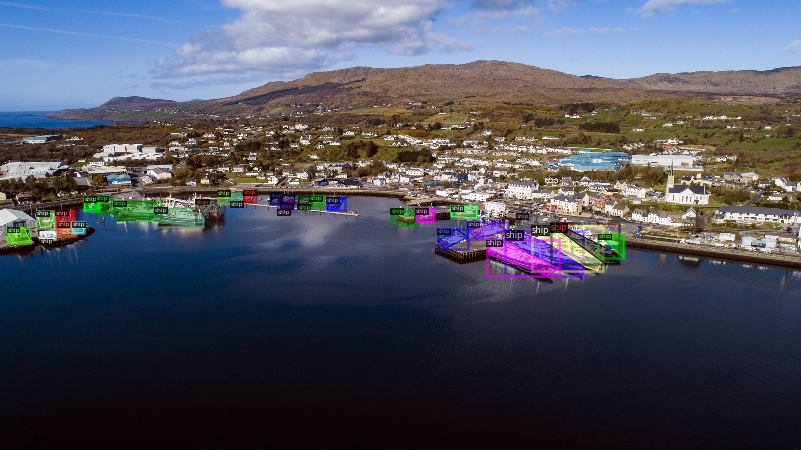

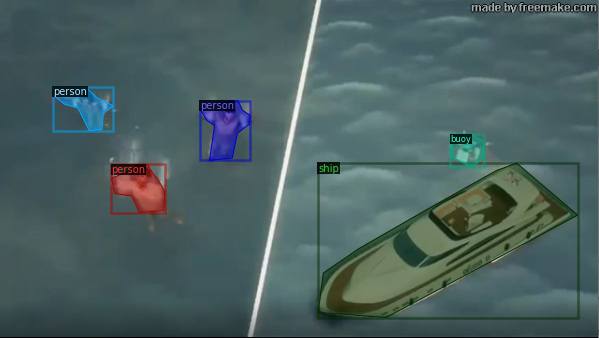

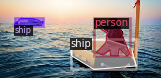

In [7]:
# check dataset is reading correctly
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")

dataset_dicts = DatasetCatalog.get("my_dataset_train")

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

# set meta data for validation set (we'll usue this later for testing)
test_metadata = MetadataCatalog.get("my_dataset_test")

You can learn more about this dataset [here](https://github.com/sagecodes/make-a-wildlife-object-detector)

In [8]:
dataset_dicts

[{'annotations': [{'bbox': [387.0537706796869,
     6.555472913994439,
     561.4608543201788,
     660.6641792587301],
    'bbox_mode': <BoxMode.XYWH_ABS: 1>,
    'category_id': 1,
    'iscrowd': 0,
    'segmentation': [[456.2922192090697,
      10.330711059653023,
      387.0537706796869,
      187.76620784104745,
      417.2669310651426,
      449.5150925176623,
      601.0635206795973,
      659.6692238858597,
      779.8245675556443,
      667.2196521727245,
      884.3118152538796,
      626.950637303509,
      930.8903694829232,
      514.952313686816,
      948.5146249998656,
      381.5610459180695,
      928.3726461362143,
      223.0016678582895,
      885.5705808822449,
      148.7555816848253,
      787.3779296857501,
      6.555472913994439,
      456.2922192090697,
      10.330711059653023]]}],
  'file_name': '/content/search-camera/img/01EVPWNNSFTY6QFRTE799RMZS4.jpeg',
  'height': 670,
  'image_id': 1,
  'width': 1255},
 {'annotations': [{'bbox': [928.7805218611654,
   

# Training a Detectron2 Model for Object Detection 

https://detectron2.readthedocs.io/tutorials/configs.html

model zoo: https://github.com/facebookresearch/Detectron/blob/master/MODEL_ZOO.md

Instance Segmentation: `COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml`

The warning: `Skip loading parameter 'roi_heads.box_predictor.cls_score.weight to the model due to incompatible shapes` is OK. It's because we have different number of classes than what the weights were trained on (81 clasess)

Optional: https://medium.com/@apofeniaco/training-on-detectron2-with-a-validation-set-and-plot-loss-on-it-to-avoid-overfitting-6449418fbf4e

In [9]:
# If you don't want to run validation you you can skip this cell
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class MyTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            output_folder = os.path.join(cfg.OUTPUT_DIR,"inference")
        return COCOEvaluator(dataset_name, cfg, True, output_folder)

In [10]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg() # initialize configuration
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")) # Define model
cfg.DATASETS.TRAIN = ("my_dataset_train",) # <- don't forget comma at end

cfg.DATALOADER.NUM_WORKERS = 0 # Can adjust for processes loading
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo (transfer learning!)
cfg.SOLVER.IMS_PER_BATCH = 2 # Image per batch per GPU
cfg.SOLVER.BASE_LR = 0.001  # pick a learning rate
cfg.SOLVER.MAX_ITER = 900    # 300 iterations seems good enough for this toy dataset; you may need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # How many classes are in your dataset



# Create output directory for training
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# Set default trainer with no validation (only have one trainer)
# cfg.DATASETS.TEST = ()
# trainer = DefaultTrainer(cfg)

### Un/comment below to run custom trainer with coco validation ###
cfg.DATASETS.TEST = ("my_dataset_val",) # you can implement a validation loader
cfg.TEST.EVAL_PERIOD = 50
trainer = MyTrainer(cfg)


trainer.resume_or_load(resume=False)
trainer.train()

[01/13 21:46:47 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:06, 66.9MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (12, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (12,) in the model! You might want to double check if this is expected.


[01/13 21:47:00 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  num_fg = fg_inds.nonzero().numel()


[01/13 21:47:28 d2.utils.events]:  eta: 0:21:22  iter: 19  total_loss: 1.944  loss_cls: 1.478  loss_box_reg: 0.2874  loss_rpn_cls: 0.06413  loss_rpn_loc: 0.06046  time: 1.4402  data_time: 0.0960  lr: 1.9981e-05  max_mem: 6248M
[01/13 21:47:57 d2.utils.events]:  eta: 0:20:53  iter: 39  total_loss: 1.826  loss_cls: 1.138  loss_box_reg: 0.3915  loss_rpn_cls: 0.14  loss_rpn_loc: 0.07762  time: 1.4402  data_time: 0.0752  lr: 3.9961e-05  max_mem: 6249M
[01/13 21:48:12 d2.data.datasets.coco]: Loaded 132 images in COCO format from /content/search-camera/validation.json
[01/13 21:48:12 d2.data.build]: Distribution of instances among all 3 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|    buoy    | 157          |   person   | 429          |    ship    | 158          |
|            |              |            |              |            |              |
|   to

In [11]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Use a Trained Model

In [12]:
!ls ./output/

events.out.tfevents.1610574409.aeccd1d30948.181.0  metrics.json
inference					   model_final.pth
last_checkpoint


In [14]:
# Initialize config
cfg = get_cfg()
# Must be same as model trained in. Sense default: COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
# Path to saved model weights (trained model)
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# if using datasets for metadata
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3
# Threshhold to show predictions
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.1
# create predictor instance to use
predictor = DefaultPredictor(cfg)

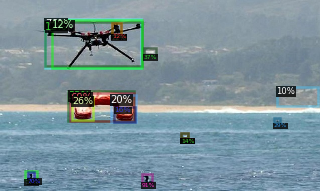

In [16]:
# Run test on an image
# from detectron2.utils.visualizer import ColorMode
test_image_path = '/content/search-camera/test/RESC002.jpg'
im = cv2.imread(test_image_path)
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.5
    )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# What does an image look like to the computer?
print(im)

[[[ 44 141 131]
  [ 43 140 130]
  [ 47 144 134]
  ...
  [ 62 141 127]
  [ 74 149 133]
  [ 74 149 133]]

 [[ 49 145 135]
  [ 47 143 133]
  [ 49 145 135]
  ...
  [ 58 135 121]
  [ 62 137 123]
  [ 68 143 129]]

 [[ 58 151 142]
  [ 55 148 139]
  [ 55 148 139]
  ...
  [ 66 142 130]
  [ 64 138 126]
  [ 76 150 138]]

 ...

 [[160 167 170]
  [156 163 166]
  [154 162 162]
  ...
  [ 85  71  59]
  [ 89  75  63]
  [ 93  79  67]]

 [[163 170 173]
  [157 164 167]
  [154 162 162]
  ...
  [ 78  65  51]
  [ 81  68  54]
  [ 84  71  57]]

 [[171 178 181]
  [163 170 173]
  [158 166 166]
  ...
  [ 89  76  62]
  [ 85  72  58]
  [ 83  70  56]]]


In [ ]:
#What does the model output look like not drawn on an image?
print(outputs["instances"].to("cpu"))

Instances(num_instances=2, image_height=600, image_width=800, fields=[pred_boxes: Boxes(tensor([[274.3538, 147.3687, 499.5619, 277.9841],
        [144.2068, 217.7411, 377.9065, 414.5187]])), scores: tensor([0.9925, 0.9666]), pred_classes: tensor([0, 0])])


In [17]:
# Count objects detected in an image
object_count = outputs["instances"].to("cpu")
print("Detected "+str(len(object_count))+" Objects")

Detected 18 Objects


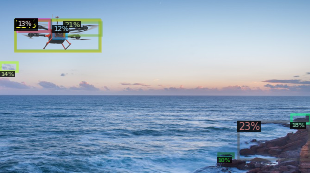

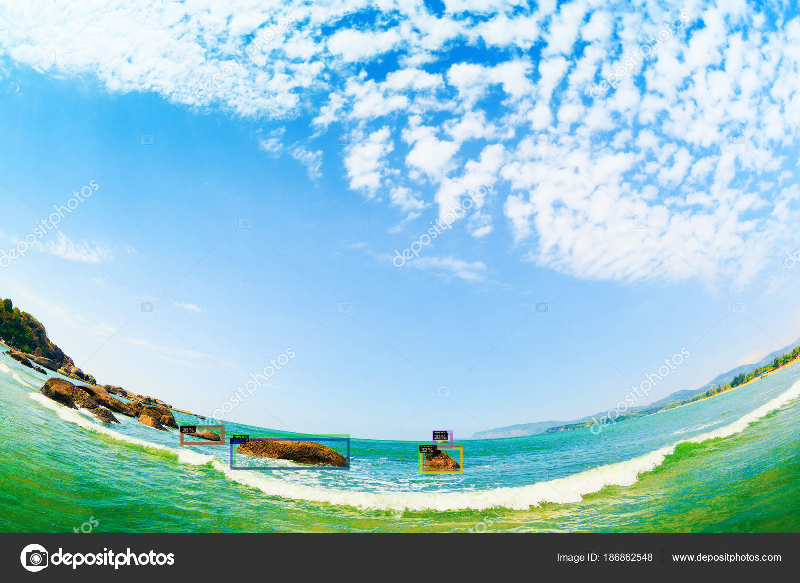

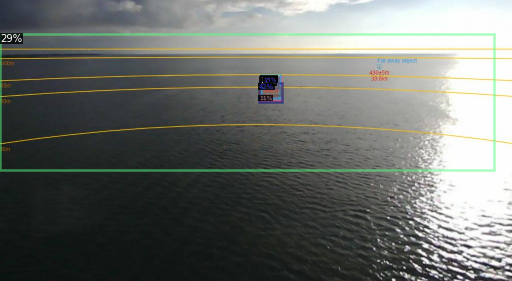

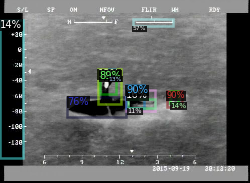

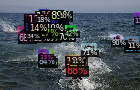

...

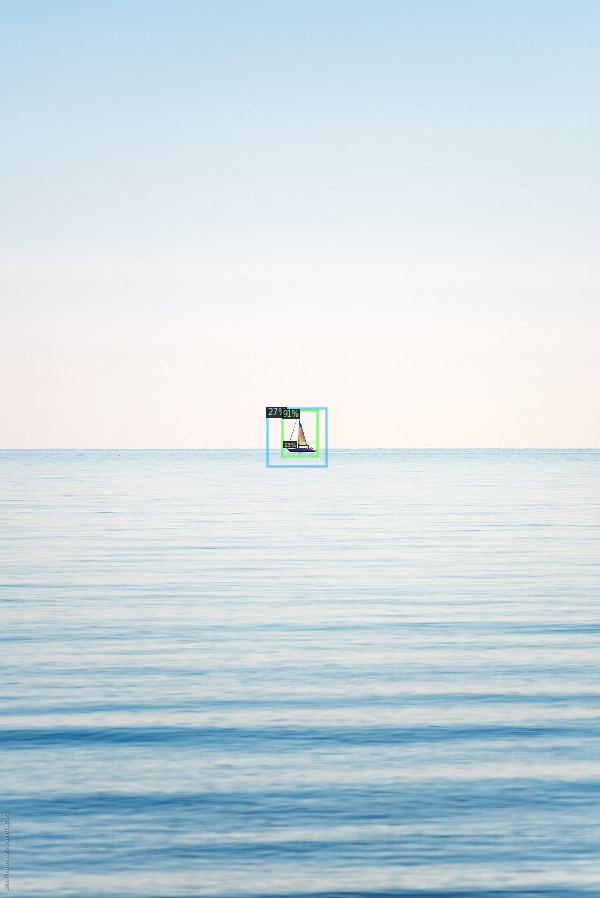

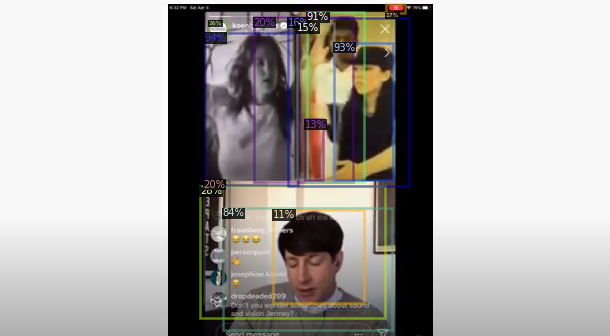

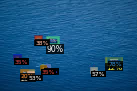

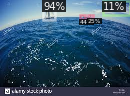

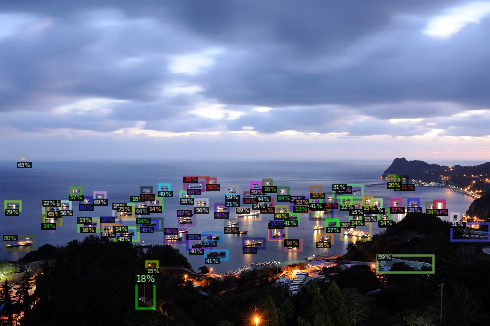

In [ ]:
# do this now for all the files in the objects directory 
directory = r'/content/search-camera/test'
for filename in os.listdir(directory):
    if filename.endswith(".jpg") or filename.endswith(".jpeg") or filename.endswith(".JPG") or filename.endswith(".png"):
        test_image_path = os.path.join(directory, filename)
        im = cv2.imread(test_image_path)
        outputs = predictor(im)
        v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.5
            )
        out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        cv2_imshow(out.get_image()[:, :, ::-1])
    else:
        continue

### Evaluation metrics

Here is great post that will go deeper into object detection evaluations metrics:

https://cocodataset.org/#detection-eval 

https://www.pyimagesearch.com/2018/05/14/a-gentle-guide-to-deep-learning-object-detection/

Detectron2 has built evaluation methods 

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [01/05 21:27:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/05 21:27:28 d2.data.datasets.coco]: Loaded 13 images in COCO format from /content/geese-object-detection-dataset/test.json
[01/05 21:27:28 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|   goose    | 32           |
|            |              |
[01/05 21:27:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/05 21:27:28 d2.data.common]: Serializing 13 elements to byte tensors and concatenating them all ...
[01/05 21:27:28 d2.data.common]: Serialized dataset takes 0.00 MiB
[01/05 21:27:28 d2.evaluation.evaluator]: Start inference on 13 images
[01/05 21:27:30 d2.evaluation.evaluator]: Inference done 11/13. 0.0959 s / img. ETA=0:00:00
[

# Run detection on a video

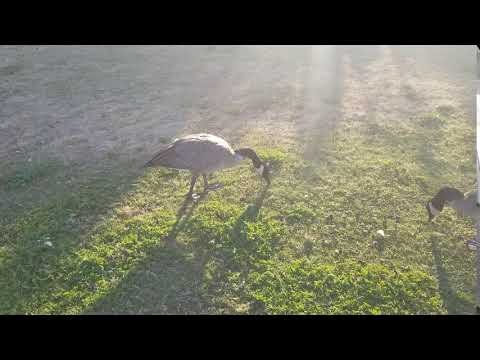

In [ ]:
# This is the video we're going to process
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("LhnqEFyenrk", width=500)
display(video)

In [ ]:
# Install dependencies, to download video, and crop for processing 
# Can skip if you are uploading your own video from google drive
!pip install youtube-dl
# !pip uninstall -y opencv-python-headless opencv-contrib-python
# !apt install python3-opencv  # the one pre-installed have some issues

In [ ]:
# Download video from youtube
!youtube-dl https://www.youtube.com/watch?v=LhnqEFyenrk -f 22 -o video.mp4

[youtube] 6vmlPXkkQ4Y: Downloading webpage
[youtube] 6vmlPXkkQ4Y: Downloading MPD manifest
[download] video.mp4 has already been downloaded
[download] 100% of 4.07MiB


In [ ]:

# Create clip from video. Useful for large videos
!ffmpeg -i /content/video.mp4 -t 00:00:06 -c:v copy video-clip.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [ ]:
from detectron2.utils.video_visualizer import VideoVisualizer
from detectron2.utils.visualizer import ColorMode, Visualizer

# Extract video properties
video = cv2.VideoCapture('video-clip.mp4')
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames_per_second = video.get(cv2.CAP_PROP_FPS)
num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# Initialize video writer
video_writer = cv2.VideoWriter('out.mp4', fourcc=cv2.VideoWriter_fourcc(*"mp4v"), fps=float(frames_per_second), frameSize=(width, height), isColor=True)

# Initialize visualizer
v = VideoVisualizer(MetadataCatalog.get(cfg.DATASETS.TEST[0]), ColorMode.IMAGE)

def runOnVideo(video, maxFrames):
    """ Runs the predictor on every frame in the video (unless maxFrames is given),
    and returns the frame with the predictions drawn.
    """

    readFrames = 0
    while True:
        hasFrame, frame = video.read()
        if not hasFrame:
            break

        # Get prediction results for this frame
        outputs = predictor(frame)

        # Make sure the frame is colored
        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

        # Draw a visualization of the predictions using the video visualizer
        visualization = v.draw_instance_predictions(frame, outputs["instances"].to("cpu"))

        # Convert Matplotlib RGB format to OpenCV BGR format
        visualization = cv2.cvtColor(visualization.get_image(), cv2.COLOR_RGB2BGR)

        yield visualization

        readFrames += 1
        if readFrames > maxFrames:
            break

# Enumerate the frames of the video
for visualization in tqdm.tqdm(runOnVideo(video, num_frames), total=num_frames):

    # Write to video file
    video_writer.write(visualization)

# Release resources
video.release()
video_writer.release()
cv2.destroyAllWindows()

In [ ]:
# Download the results
from google.colab import files
files.download('out.mp4')

# Keep Learning!

We just scratched the surface of the computer vision field, but I hope you feel confidant and inspired to learn more about it and creat your own projects! 

[Sign up for Sense Data Annotation](https://sixgill.tech/sense-data-annotation) & Start Labeling your own datasets! Retrain this notebook with them.

[Join me in slack](https://bit.ly/30lO9Cq) to ask any questions.

Follow Sixgill on [Medium](https://medium.com/sixgill) for Computer Vision Tutorials

Subscribe on [youtube](https://www.youtube.com/channel/UCWt--5NcY-O9PhjfPSDotew) for more content around computer vision.

Read/watch [my talk](https://github.com/sagecodes/make-a-wildlife-object-detector) on how to think about data and create sythetic data to improve your models.


### Learn more about different object detection methods:


- Single Shot MultiBox Detector (SSD) [explained](https://towardsdatascience.com/understanding-ssd-multibox-real-time-object-detection-in-deep-learning-495ef744fab) | [paper](https://arxiv.org/abs/1512.02325)

- You Only Look Once (YOLO) [Explained](https://medium.com/@jonathan_hui/real-time-object-detection-with-yolo-yolov2-28b1b93e2088) | [Paper](https://arxiv.org/abs/1506.02640) 

- Mask R-CNN [Explained](https://medium.com/@jonathan_hui/image-segmentation-with-mask-r-cnn-ebe6d793272) | [Paper](https://arxiv.org/abs/1703.06870)

- Detectron2 [github](https://github.com/facebookresearch/detectron2) | [official coloab](https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5)

[Pyimagesearch](https://www.pyimagesearch.com/category/object-detection/) and [Machine Learning Mastery](https://machinelearningmastery.com/) are a great resources to take a look at. 


-------------------

#### Raw Links for chat:
https://sixgill.tech/sense-data-annotation

https://www.linkedin.com/in/sageelliott/

https://twitter.com/sagecodes

https://github.com/sagecodes

https://medium.com/sixgill

https://github.com/sagecodes/make-a-wildlife-object-detector

https://sixgill.tech/slack


